# **Lista 7 - Visualização de dados**

#### **Fala devs, beleza?**
Bem vindos à ultima lista de exercícios do nosso curso! Aqui serão abordados assuntos envolvendo o tema de "Visualização de dados". <br><br>Usaremos um *dataset* de dados de uma certa clínica médica, em que cada observação corresponde a um paciente.

<h3> Importando os dados

Antes de iniciar o processo de visualização, é necessário que importemos os dados do arquivo .csv, bem como as bibliotecas que iremos utilizar:

In [3]:
### Importando as bibliotecas
# Caso precise instalar alguma biblioteca use: %pip install nome_da_biblioteca
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [4]:
### Carregando o dataset
data = pd.read_csv("dataset_dev.csv")

Uma vez importados, podemos buscar entender a estrutura dos dados e a forma como foram organizados, por meio da exploração dos mesmos:

In [5]:
data.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,country,previous_cancellations,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,PRT,0,3,0,0.0,0,0,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,PRT,0,4,0,0.0,0,0,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,0.0,0,GBR,0,0,0,75.0,0,0,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,0.0,0,GBR,0,0,0,75.0,0,0,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,0.0,0,GBR,0,0,0,98.0,0,1,2015-07-03


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118898 entries, 0 to 118897
Data columns (total 20 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   hotel                        118898 non-null  object 
 1   is_canceled                  118898 non-null  int64  
 2   lead_time                    118898 non-null  int64  
 3   arrival_date_year            118898 non-null  int64  
 4   arrival_date_month           118898 non-null  object 
 5   arrival_date_week_number     118898 non-null  int64  
 6   arrival_date_day_of_month    118898 non-null  int64  
 7   stays_in_weekend_nights      118898 non-null  int64  
 8   stays_in_week_nights         118898 non-null  int64  
 9   adults                       118898 non-null  int64  
 10  children                     118898 non-null  float64
 11  babies                       118898 non-null  int64  
 12  country                      118898 non-null  object 
 13 

In [7]:
data.shape

(118898, 20)

Breve descrição das colunas: <br><br>

**hotel**: Tipo de hotel (Resort Hotel ou City Hotel).

**is_canceled**: Indica se a reserva foi cancelada (0 para não cancelada, 1 para cancelada).

**lead_time**: Número de dias entre a data da reserva e a data de chegada.

**arrival_date_year**: Ano da data de chegada.

**arrival_date_month**: Mês da data de chegada.

**arrival_date_week_number**: Número da semana do ano da data de chegada.

**arrival_date_day_of_month**: Dia do mês da data de chegada.

**stays_in_weekend_nights**: Número de noites de estadia durante os fins de semana.

**stays_in_week_nights**: Número de noites de estadia durante os dias de semana.

**adults**: Número de adultos.

**children**: Número de crianças.

**babies**: Número de bebês.

**country**: País de origem.

**previous_cancellations**: Número de reservas canceladas anteriormente pelo cliente.

**booking_changes**: Número de alterações feitas na reserva.

**days_in_waiting_list**: Número de dias na lista de espera antes da confirmação da reserva.

**adr**: Tarifa média diária (Average Daily Rate).

**required_car_parking_spaces**: Número de vagas de estacionamento necessárias.

**total_of_special_requests**: Número total de pedidos especiais feitos pelo cliente.

**reservation_status_date**: Data da última atualização do status da reserva.

A partir dessas informações, já podemos iniciar o processo de visualização de dados. E assim sendo, agora é com vocês!!

# Exercícios

<h2> Questão 1

#### Faça um gráfico que relacione a quantidade de dias de antecedência da reserva com a tarifa média diária:

In [5]:
### REMOÇÃO DOS OUTLIERS ###
from scipy import stats
z_scores = stats.zscore(data['adr'])
threshold = 3
data = data[(z_scores < threshold)]

In [12]:
### SEU CÓDIGO COMEÇA AQUI ###
plt.rcParams['figure.figsize'] = (4,2) #400px por 200 px
plt.rcParams['figure.constrained_layout.use'] = True

# selecionando as colunas
lead_time = data['lead_time']
adr = data['adr']

# criando o gráfico
plt.figure(figsize=(5, 3))
# lead time no eixo x e adr no eixo y
plt.scatter(lead_time, adr, alpha=0.7)

plt.title('Gráfico Questão 1')
plt.xlabel('Quantidade de dias de antecedência da reserva')
plt.ylabel('Tarifa média diária')
# colocando o grid
plt.grid(True)

## Questão 2

#### a) Faça um gráfico para analisar a quantidade de hoteis de cada tipo na amostra

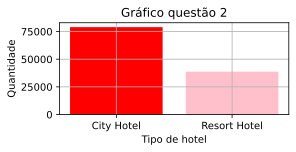

In [14]:
### SEU CÓDIGO COMEÇA AQUI ###

# contando a frequência de cada hotel
freq_hotel = data['hotel'].value_counts()
# criando o gráfico
plt.figure
# crinado as barras, os índices são os tipos de hotel(x) e value são a quantidade(y)
plt.bar(freq_hotel.index, freq_hotel.values, color=['red', 'pink'])
plt.title('Gráfico questão 2')
plt.xlabel('Tipo de hotel')
plt.ylabel('Quantidade')
plt.grid()


#### b) Agora, faça um gráfico para analisar a quantidade de reservas canceladas para cada tipo de hotel
dica: dê uma olhada na função ```.countplot()``` do *Seaborn*

Text(0, 0.5, 'Quantidade de cancelamentos')

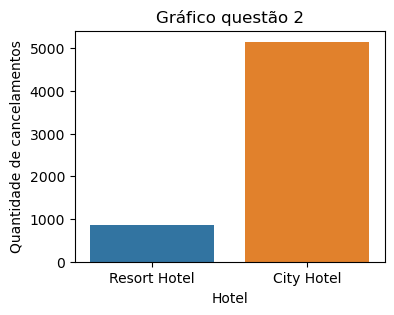

In [9]:
### SEU CÓDIGO COMEÇA AQUI ###
# vendo quais reservas foram canceladas e incluindo no novo df
canceladas = data[data['previous_cancellations'] == 1]
plt.figure(figsize=(4,3))
sns.countplot(data=canceladas, x='hotel')
plt.title('Gráfico questão 2')
plt.xlabel('Hotel')
plt.ylabel('Quantidade de cancelamentos')



## Questão 3

### a) Faça um gráfico que demonstre a quantidade de noites de estadia durante os fins de semana, dividindo o gráfico em 20 intervalos distintos: <br> 
Dica: tente utilizar o parâmetro '*bins*' do matplotlib para selecionar a quantidade de grupos que deseja utilizar

([<matplotlib.axis.XTick at 0x26dc38aa290>,
 [Text(1, 0, '1'),
  Text(2, 0, '2'),
  Text(3, 0, '3'),
  Text(4, 0, '4'),
  Text(5, 0, '5'),
  Text(6, 0, '6'),
  Text(7, 0, '7'),
  Text(8, 0, '8'),
  Text(9, 0, '9'),
  Text(10, 0, '10'),
  Text(11, 0, '11'),
  Text(12, 0, '12'),
  Text(13, 0, '13'),
  Text(14, 0, '14'),
  Text(15, 0, '15'),
  Text(16, 0, '16'),
  Text(17, 0, '17'),
  Text(18, 0, '18'),
  Text(19, 0, '19'),
  Text(20, 0, '20')])

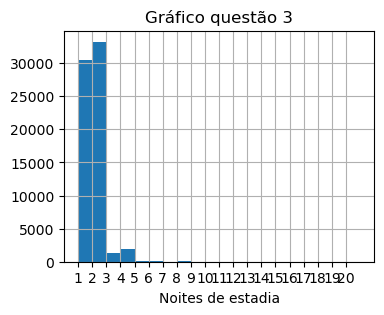

In [22]:
### SEU CÓDIGO COMEÇA AQUI ###
plt.figure(figsize=(4,3))
# são vinte bins de 1 a 20
plt.hist(data['stays_in_weekend_nights'], bins=20, range=(1, 21))

plt.title('Gráfico questão 3')
plt.xlabel('Noites de estadia')
plt.grid()
# marca o eixo x de 1 a 20
plt.xticks(np.arange(1, 21, step=1)) 


### b) Agora, faça a mesma coisa para as estadias em dias da semana:

([<matplotlib.axis.XTick at 0x26dc3972950>,
 [Text(1, 0, '1'),
  Text(2, 0, '2'),
  Text(3, 0, '3'),
  Text(4, 0, '4'),
  Text(5, 0, '5'),
  Text(6, 0, '6'),
  Text(7, 0, '7'),
  Text(8, 0, '8'),
  Text(9, 0, '9'),
  Text(10, 0, '10'),
  Text(11, 0, '11'),
  Text(12, 0, '12'),
  Text(13, 0, '13'),
  Text(14, 0, '14'),
  Text(15, 0, '15'),
  Text(16, 0, '16'),
  Text(17, 0, '17'),
  Text(18, 0, '18'),
  Text(19, 0, '19'),
  Text(20, 0, '20')])

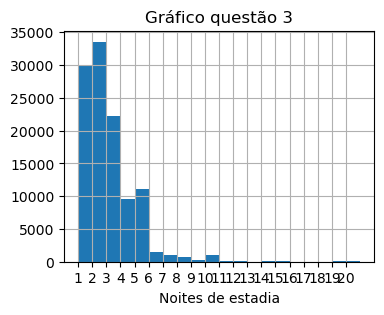

In [23]:
### SEU CÓDIGO COMEÇA AQUI ###
plt.figure(figsize=(4,3))
# são vinte bins de 1 a 20
plt.hist(data['stays_in_week_nights'], bins=20, range=(1, 21))

plt.title('Gráfico questão 3')
plt.xlabel('Noites de estadia')
plt.grid()
# marca o eixo x de 1 a 20
plt.xticks(np.arange(1, 21, step=1)) 



### c) Por fim, relacione o número de dias de estadia nos fins de semana e nos dias de semana, diferenciando-os pelo tipo de hotel (ou seja, city hotel ou resort hotel):

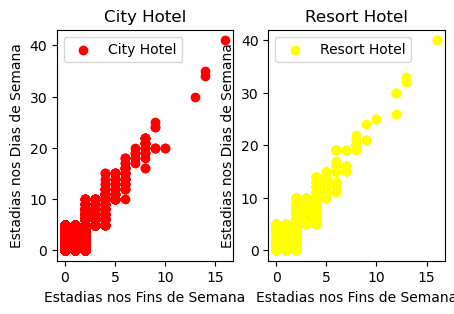

In [32]:
### SEU CÓDIGO COMEÇA AQUI ###
city_hotel = data[data['hotel'] == 'City Hotel']
resort_hotel = data[data['hotel'] == 'Resort Hotel']
plt.figure(figsize=(5,3))


plt.subplot(1, 2, 1) 
plt.scatter(city_hotel['stays_in_weekend_nights'], city_hotel['stays_in_week_nights'], color='red', label='City Hotel')
plt.title('City Hotel')
plt.xlabel('Estadias nos Fins de Semana')
plt.ylabel('Estadias nos Dias de Semana')
plt.legend()

plt.subplot(1, 2, 2)  
plt.scatter(resort_hotel['stays_in_weekend_nights'], resort_hotel['stays_in_week_nights'], color='yellow', label='Resort Hotel')
plt.title('Resort Hotel')
plt.xlabel('Estadias nos Fins de Semana')
plt.ylabel('Estadias nos Dias de Semana')
plt.legend()



## Questão 4

### a) Faça um gráfico que nos permita ver a evolução temporal das taxas médias diárias ao decorrer dos meses do ano
Dica: neste exercício, pode-se fazer útil o uso do parâmetro '*errorbar*' da biblioteca seaborn para refinar o seu gráfico

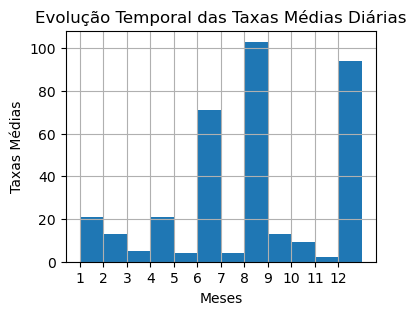

In [54]:
plt.figure(figsize=(4,3))
plt.hist(data['adr'], bins=12, range=(1, 13))
plt.title('Evolução Temporal das Taxas Médias Diárias')
plt.xlabel('Meses')
plt.ylabel('Taxas Médias')
plt.xticks(np.arange(1, 13, step=1)) 
plt.grid()



### b) Faça um gráfico que nos permita ver a evolução temporal das taxas médias diárias ao decorrer dos anos

## Questão 5

### Faça um gráfico que nos permita analisar a correlação entre todas as colunas numéricas ao mesmo tempo

Text(0.5, 1.0, 'correlação')

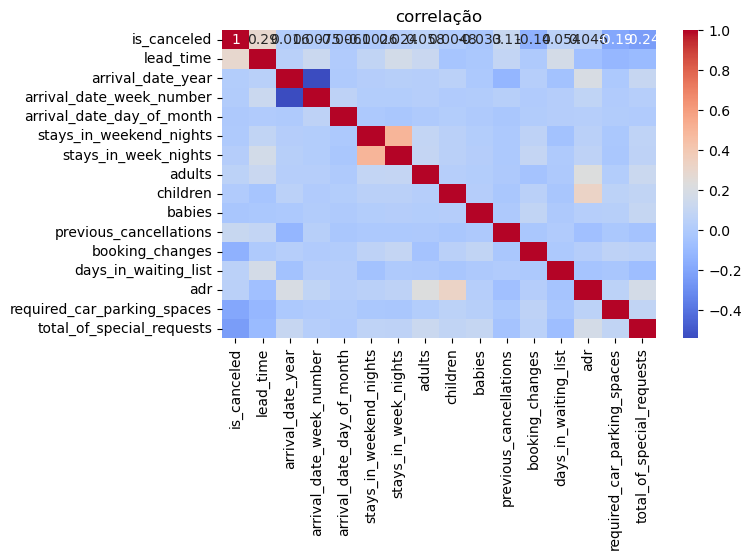

In [64]:
colunas_numericas = data.select_dtypes(include=['float64', 'int64'])
correlation_matrix = colunas_numericas.corr()
plt.figure(figsize=(7,4))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('correlação')

## Questão 6

### Faça um gráfico interativo e dinâmico da distribuição do número de dias entre a data da reserva e a da chegada, e do tipo de hotel

In [70]:
### SEU CÓDIGO COMEÇA AQUI ###
city_hotel = data[data['hotel'] == 'City Hotel']
resort_hotel = data[data['hotel'] == 'Resort Hotel']
fig = px.scatter(city_hotel['lead_time'], city_hotel['lead_time'])
fig.show()